In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os
%matplotlib inline

# Calibrate Camera

In [2]:
def calibrate_camera(dir, nx=9, ny=6):
    assert os.path.exists(dir)
    
    # Read in and make a list of calibration images
    # It's recommend to read at least 20 images to get a good calibration
    images = glob.glob('./camera_cal/calibration*.jpg')
    
    # arrays to store object points and image points from all the images
    objpoints = [] # 3D points in real world space
    imgpoints = [] # 2D points in image plane

    # prepare object points
    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2) # x, y coordinates

    for idx, fname in enumerate(images):
        # read in an image
        img = cv2.imread(fname)

        # convert image to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        print("Image {} corner found?: {}".format(idx, ret))

        # If found, add object points, image points
        if ret==True:
            imgpoints.append(corners)
            objpoints.append(objp)

            # draw and display the corners
            img = cv2.drawChessboardCorners(gray, (8,6), corners, ret)

    # calibreate Camera
    ret, mtx, dist, rvec, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    print("Camera calibrated.")
    return mtx, dist
    

In [3]:
mtx, dist = calibrate_camera('camera_cal/')

Image 0 corner found?: False
Image 1 corner found?: True
Image 2 corner found?: True
Image 3 corner found?: True
Image 4 corner found?: True
Image 5 corner found?: True
Image 6 corner found?: True
Image 7 corner found?: True
Image 8 corner found?: True
Image 9 corner found?: True
Image 10 corner found?: True
Image 11 corner found?: True
Image 12 corner found?: True
Image 13 corner found?: True
Image 14 corner found?: False
Image 15 corner found?: False
Image 16 corner found?: True
Image 17 corner found?: True
Image 18 corner found?: True
Image 19 corner found?: True
Camera calibrated.


# Distortion correction

In [4]:
def undistort(img, mtx=mtx, dist=dist):
    undistort = cv2.undistort(img, mtx, dist, None, mtx)
    return undistort

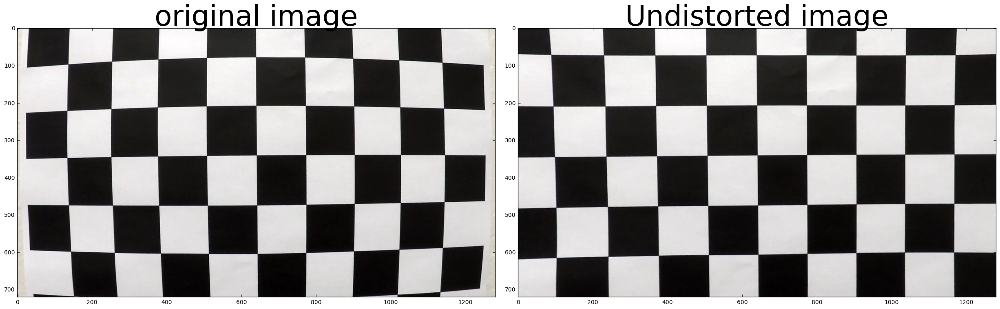

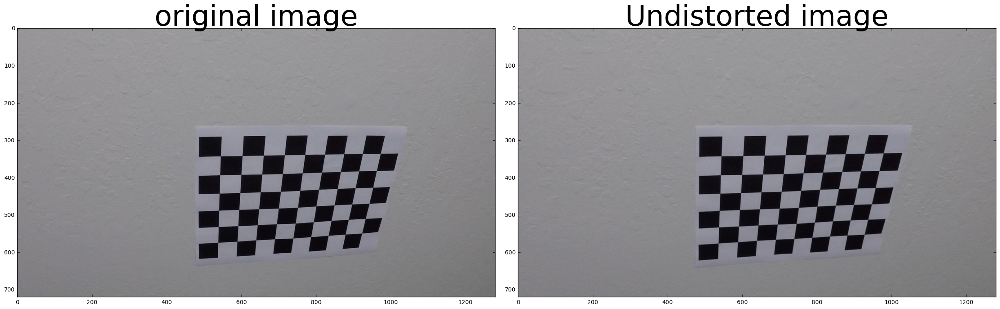

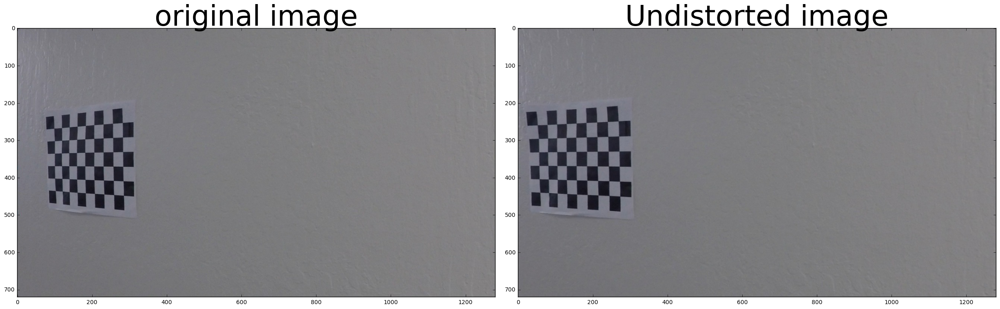

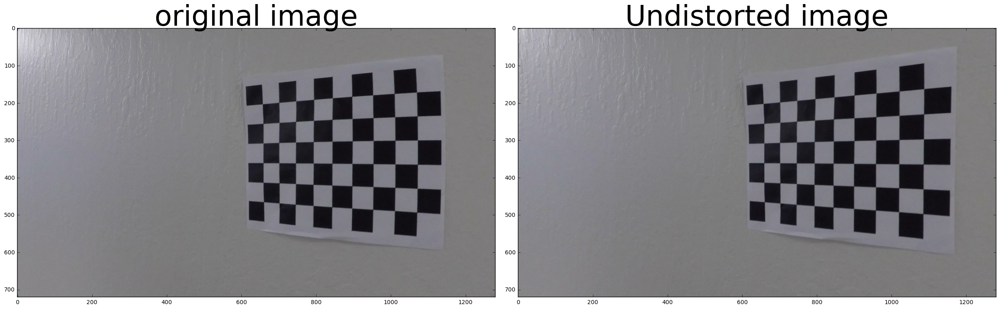

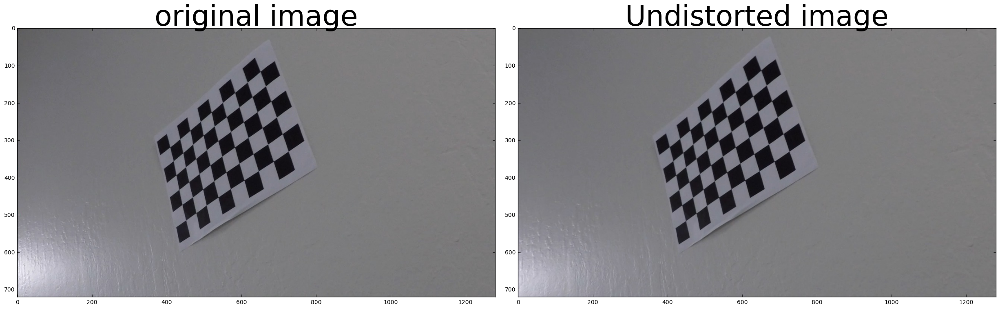

...

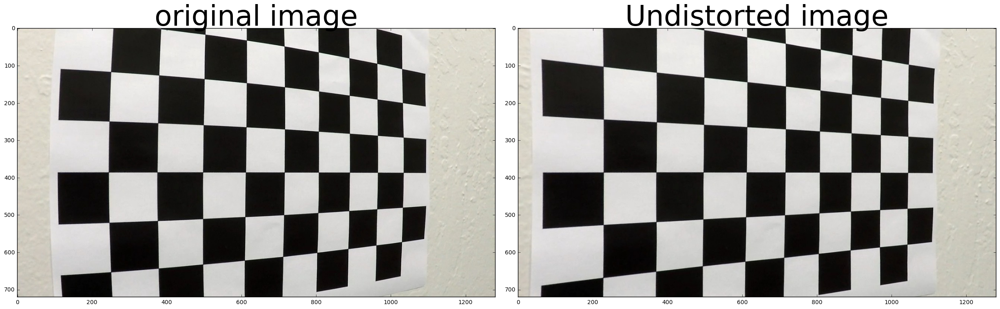

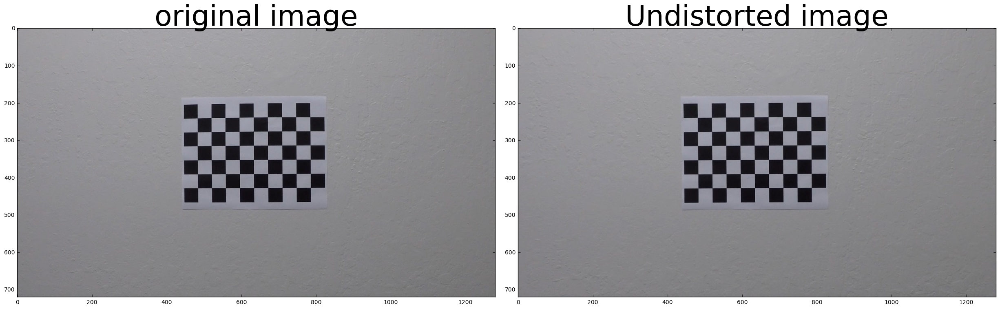

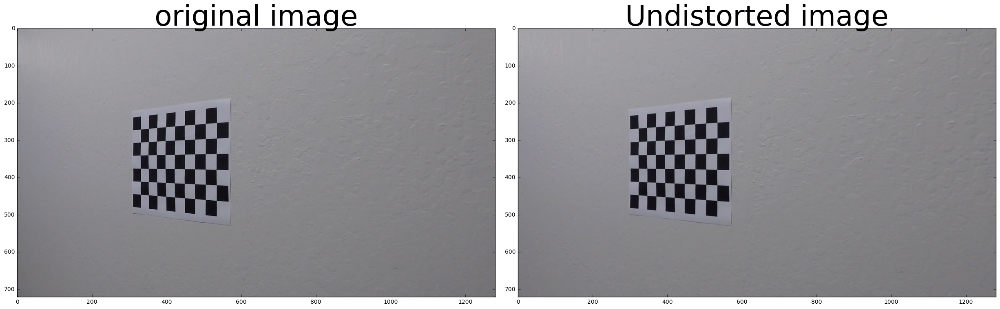

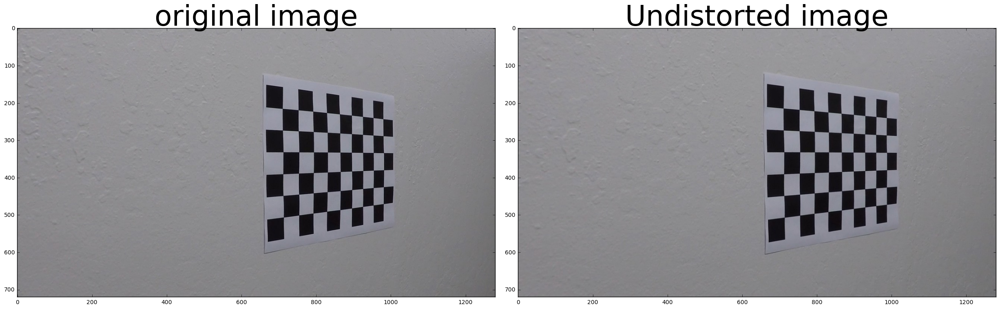

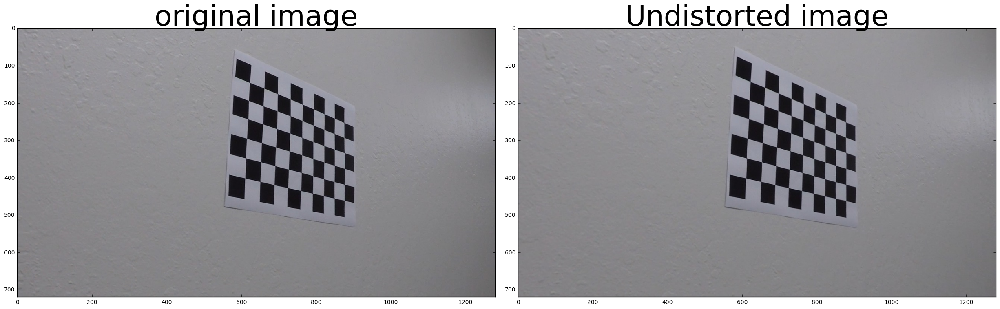

In [5]:
for img_path in glob.glob('camera_cal/calibration*.jpg'):
    img = mpimg.imread(img_path)
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(24, 9))
    f.tight_layout()
    ax1.set_title("original image", fontsize=50)
    ax1.imshow(img)
    img_undistort = undistort(img)
    ax2.set_title("Undistorted image", fontsize=50)
    ax2.imshow(img_undistort)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Color/gradient threshold

In [ ]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient
    # Apply threshold
    return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold
    return dir_binary


# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(0, 255))
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(0, 255))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(0, 255))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0, np.pi/2))


combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

# Perspective transform

In [ ]:
def transform(undistort):
    gray = cv2.cvtColor(undistort, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    if ret == True:
        offset = 100
        img_size = (img.shape[1], img.shape[0])
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(undistort, M, img_size, flags=cv2.INTER_LINEAR)
        
    return warped, M

Camera calibration
Distortion correction
Color/gradient threshold
Perspective transform
Detect lane lines
Determine the lane curvature

In [ ]:
if __name__ == "__main__":
    mtx, dist = calibrate_camera('camera_cal/')
    images = glob.glob('test_images/test*.jpg')
    

# 